In [130]:
import os, sys
import networkx as nx
from collections import defaultdict
import re
import pandas as pd
import json

import matplotlib.pyplot as plt
%matplotlib inline

from fa2 import ForceAtlas2

import numpy as np
import nltk
from nltk.corpus import stopwords
import progressbar

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import community

from PIL import Image
import random

In [46]:
# Function to calculate TF-IDF
def TFIDF(dataframes):
    dataframes_tfidf = []
    all_words = []
    
    #Caclulate TF
    for i in range(len(dataframes)):
        df = dataframes[i]
        df_tfidf = df.groupby("word").size()
        df_words = df_tfidf.index
        df_counts = df_tfidf.values
        
        df_tfidf = pd.DataFrame(data=dict(word=df_words, TF=df_counts))
        df_tfidf.sort_values(by="TF", ascending=False)
        df_tfidf.reset_index(inplace=True)
        dataframes_tfidf.append(df_tfidf)
        
        all_words.extend(df_words)
    
    df_all = pd.DataFrame(data=dict(word=all_words))
    df_all = df_all.groupby("word").size()
    df_all_words = df_all.index
    df_all_counts = df_all.values
    df_all = pd.DataFrame(data=dict(word=df_all_words,
                                    count=df_all_counts))
    #Calculate IDF
    N = len(dataframes)
    for i in range(len(dataframes_tfidf)):
        df = dataframes_tfidf[i]
        df_merged = pd.merge(df, df_all, on="word")
        df_merged["IDF"] = N/(1+np.log(df_merged["count"]))
        df_merged["TFIDF"] = df_merged["TF"] * df_merged["IDF"]
        df_merged.sort_values(by="TFIDF", ascending=False)
        dataframes_tfidf[i] = df_merged
    
    return dataframes_tfidf



In [25]:
# Download the list of word sentiments
word_sentiments = pd.read_csv("../data/sentiment.csv")[["word", "happiness_rank", "happiness_average", "happiness_standard_deviation"]]

# A function that calculates the sentiment of a list of tokens
def evaluate_sentiment(tokens):
    # Convert tokens list to dataframe
    df = pd.DataFrame(data=dict(word=tokens))
    # Count how many times each word is mentioned
    df2 = df.groupby("word").size()
    words = df2.index.values
    # Convert counts to frequency
    freq = df2.values / float(len(tokens))
    
    # DataFrame with word frequencies
    df_final = pd.DataFrame(data=dict(word=words, freqs=freq))
    
    # Calculate the sentiment using word frequency and word happiness
    df_final = df_final.merge(word_sentiments, on="word")
    df_final["havg"] = df_final["happiness_average"]*df_final["freqs"]
    
    return sum(df_final["havg"])

In [20]:
#Read the scripts json
with open("starwars_transcripts_springfield.json", 'r') as f:
    transcript_json = json.load(f)

print transcript_json["data"].keys()
print transcript_json["data"]["series"]["Star Wars: The Clone Wars (series)"]["Deception"].keys()

[u'movies', u'series']
[u'transcript', u'episode']


In [27]:
movies = ["Star Wars: Episode I The Phantom Menice", "Star Wars: Episode II Attack of the Clones",
        "Star Wars: The Clone Wars (film)", "Star Wars: Episode III Revenge of the Sith",
        "Solo: A Star Wars Story", "Rogue One: A Star Wars Story", "Star Wars: Episode IV A New Hope",
        "Star Wars: Episode V The Empire Strikes Back", "Star Wars: Episode VI Return of the Jedi",
        "Star Wars: Episode VII The Force Awakens", "Star Wars: Episode VIII The Last Jedi"]

animated_series_names = ["Star Wars: The Clone Wars (series)", "Star Wars Rebels"]

media_in_time_order = [("movies", "Star Wars: Episode I The Phantom Menice"), ("movies", "Star Wars: Episode II Attack of the Clones"),
                       ("movies", "Star Wars: The Clone Wars (film)"),
                       ("series", "Star Wars: The Clone Wars (series)"),
                       ("movies", "Star Wars: Episode III Revenge of the Sith"),
                       ("movies", "Solo: A Star Wars Story"), 
                       ("series", "Star Wars Rebels"),
                       ("movies", "Rogue One: A Star Wars Story"), ("movies", "Star Wars: Episode IV A New Hope"),
                       ("movies", "Star Wars: Episode V The Empire Strikes Back"), ("movies", "Star Wars: Episode VI Return of the Jedi"),
                       ("movies", "Star Wars: Episode VII The Force Awakens"), ("movies", "Star Wars: Episode VIII The Last Jedi")]

In [152]:
# Tokenize all the transcripts
transcript_tokens = defaultdict(dict)
dataframes = []
for m in movies:
    script = transcript_json["data"]["movies"][m]["transcript"]
    
    tokens = []

    # Only detect words and abbreviations, not numbers or punctuations
    pattern = r'''(?x)    # set flag to allow verbose regexps
        (?:[A-Z]\.)+        # abbreviations, e.g. U.S.A.
      | [A-Za-z]\w*(?:-\w+)*  # words with optional internal hyphens
      '''
    stopw = stopwords.words('english')
    other_words = []
    # Tokenize the text with regex
    tokens = nltk.regexp_tokenize(script, pattern)
    # Exclude twitter handles and stopwords from the list of tokens and set the token to lowercase
    tokens = [t.lower() for t in tokens if ((t.lower() not in stopw) and (t.lower() not in other_words))]

    df_tokens = pd.DataFrame(data=dict(word=tokens))
    dataframes.append(df_tokens)
    transcript_tokens[m]["tokens"] = df_tokens
    transcript_tokens[m]["sentiment"] = evaluate_sentiment(tokens)

for s in animated_series_names:
    all_tokens = []
    for e in transcript_json["data"]["series"][s]:
        script = transcript_json["data"]["series"][s][e]["transcript"]
        enumber = transcript_json["data"]["series"][s][e]["episode"]
        
        tokens = []

        # Only detect words and abbreviations, not numbers or punctuations
        pattern = r'''(?x)    # set flag to allow verbose regexps
            (?:[A-Z]\.)+        # abbreviations, e.g. U.S.A.
          | [A-Za-z]\w*(?:-\w+)*  # words with optional internal hyphens
          '''
        stopw = stopwords.words('english')
        other_words = []
        # Tokenize the text with regex
        tokens = nltk.regexp_tokenize(script, pattern)
        # Exclude twitter handles and stopwords from the list of tokens and set the token to lowercase
        tokens = [t.lower() for t in tokens if ((t.lower() not in stopw) and (t.lower() not in other_words))]

        df_tokens = pd.DataFrame(data=dict(word=tokens))
#         dataframes.append(df_tokens)
        all_tokens.extend(tokens)
        transcript_tokens[s][e] = {"tokens": df_tokens, "episode": enumber, "sentiment": evaluate_sentiment(tokens)}
        
    df_all_tokens = pd.DataFrame(data=dict(word=all_tokens))
    dataframes.append(df_all_tokens)
    transcript_tokens[s]["all_tokens"] = df_all_tokens

        
tfidf_dataframes = TFIDF(dataframes)
for i in range(len(movies)):
    transcript_tokens[movies[i]]["TFIDF"] = tfidf_dataframes[i]

j = i+1
for x in animated_series_names:
    transcript_tokens[x]["TFIDF"] = tfidf_dataframes[j]
    j += 1
#     for e in transcript_json["data"]["series"][s]:
#         transcript_tokens[s][e]["TFIDF"] = tfidf_dataframes[j]
#         j += 1

In [154]:
sentiment_by_time = []
media_name = []
for cat, name in media_in_time_order:
    if cat == "movies":
        sentiment_by_time.append(transcript_tokens[name]["sentiment"])
        media_name.append(name)
    if cat == "series":
        episode_list = []
        sentiment_list = []
        for e in transcript_tokens[name]:
            if e not in ("TFIDF", "all_tokens"):
                episode_list.append(transcript_tokens[name][e]["episode"])
                sentiment_list.append(transcript_tokens[name][e]["sentiment"])
                df_temp = pd.DataFrame(data=dict(episode=episode_list, sentiment=sentiment_list))
                df_temp = df_temp.sort_values(by="episode", ascending=True)
        sentiment_by_time.extend(df_temp.sentiment.values)
        media_name.extend(["{0} - {1}".format(name, x) for x in df_temp.episode.values])

sentiment_json = {"data": {"sentiment": sentiment_by_time, "name": media_name}}
with open("Data/sentiment.json", 'w') as f:
    json.dump(sentiment_json, f)
plt.figure(figsize=(200, 200))
plt.plot(media_name, sentiment_by_time)
plt.xticks(range(len(media_name)), media_name, fontsize=50, rotation=90)
# Do axis manipulation

([<matplotlib.axis.XTick at 0xe4b6e80>,
 <a list of 199 Text xticklabel objects>)

Star Wars: Episode I The Phantom Menice
1584
Star Wars: Episode II Attack of the Clones
1545
Star Wars: The Clone Wars (film)
1281
Star Wars: Episode III Revenge of the Sith
1158
Solo: A Star Wars Story
1632
Rogue One: A Star Wars Story
1272
Star Wars: Episode IV A New Hope
1580
Star Wars: Episode V The Empire Strikes Back
1226
Star Wars: Episode VI Return of the Jedi
1290
Star Wars: Episode VII The Force Awakens
1149
Star Wars: Episode VIII The Last Jedi
1346
Star Wars: The Clone Wars (series)
9467
Star Wars Rebels
6474


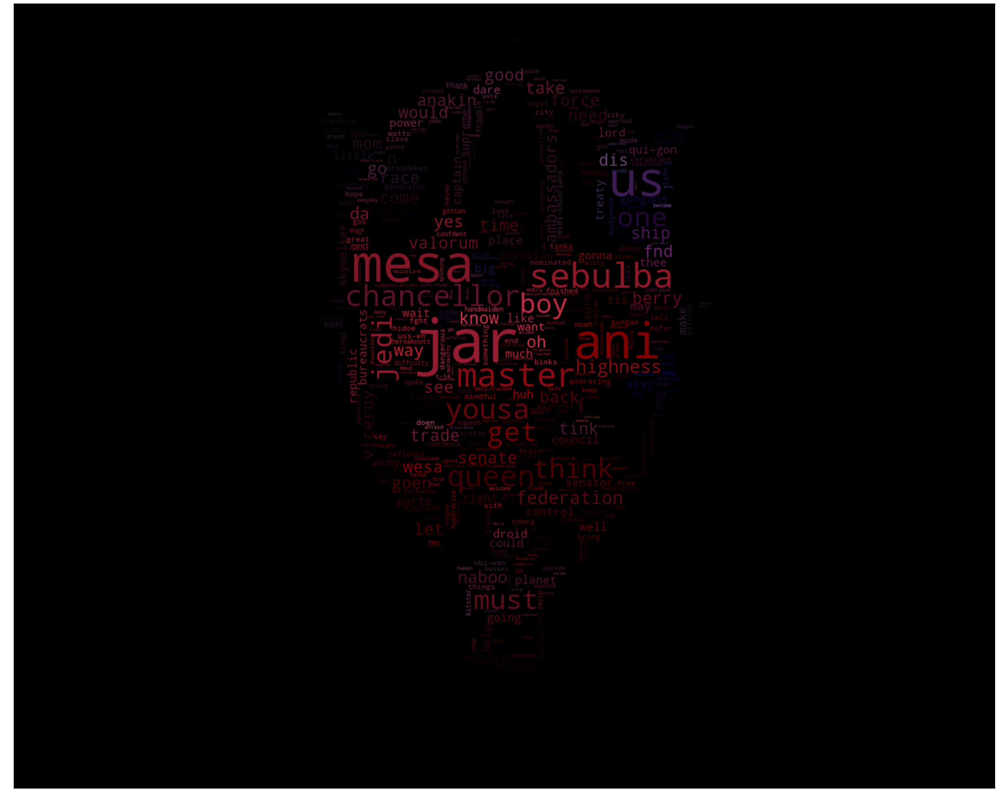

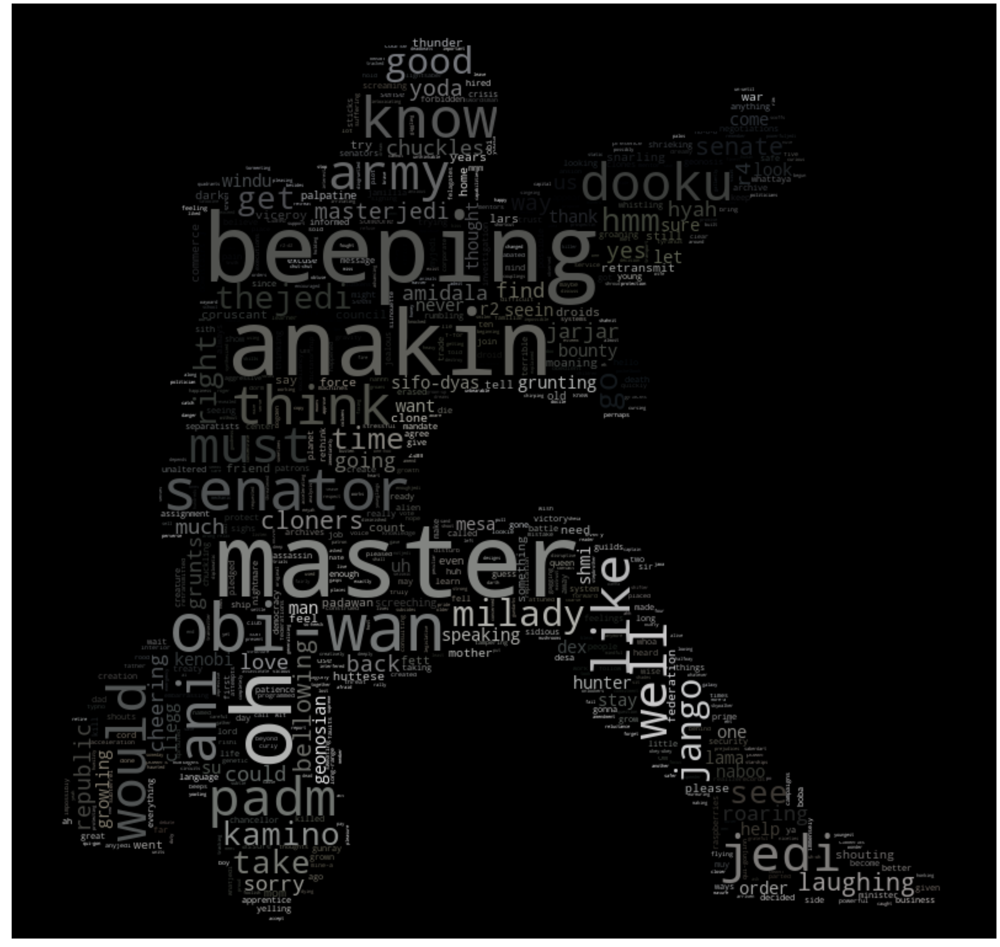

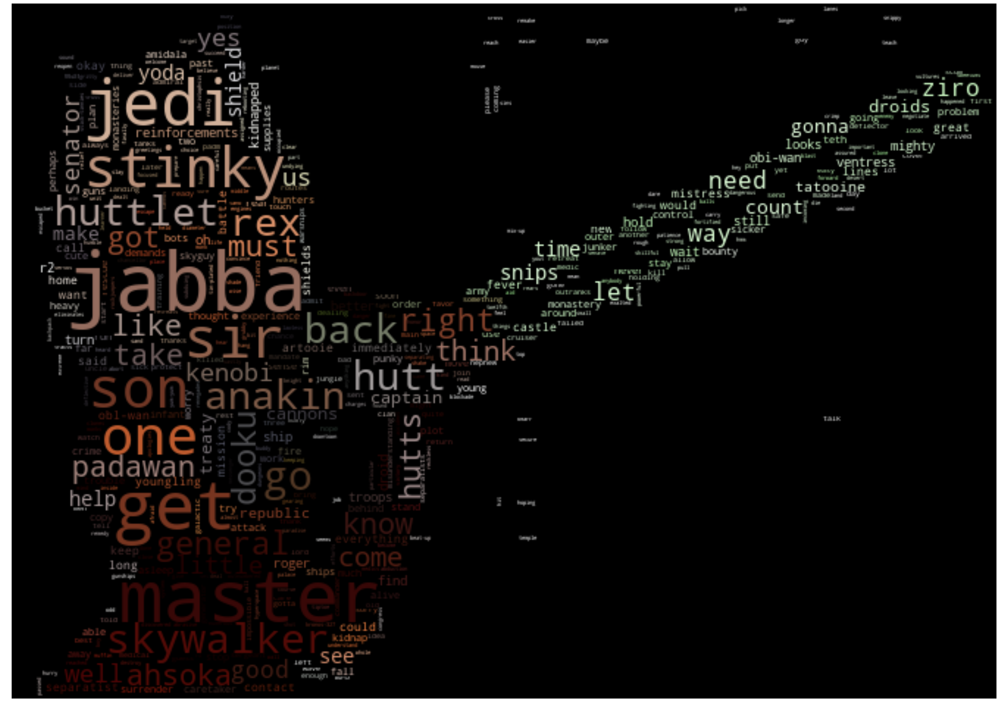

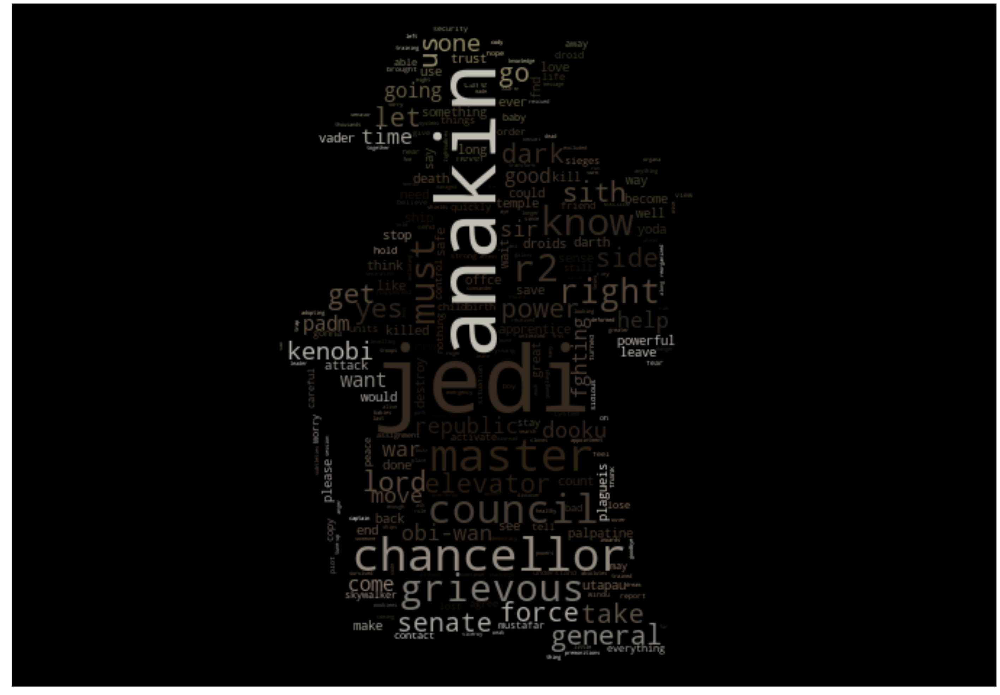

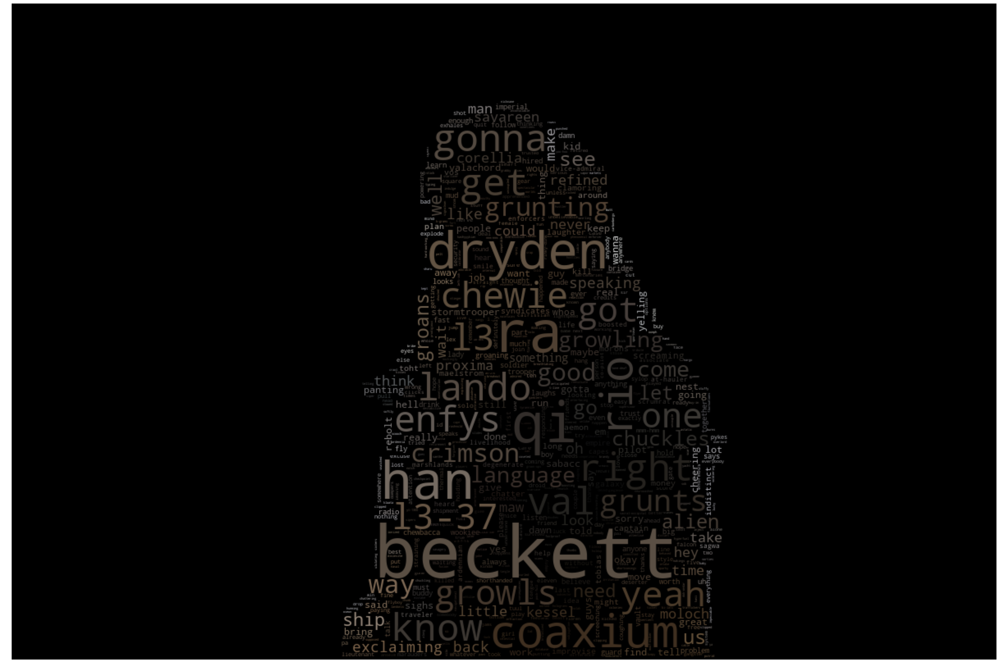

...

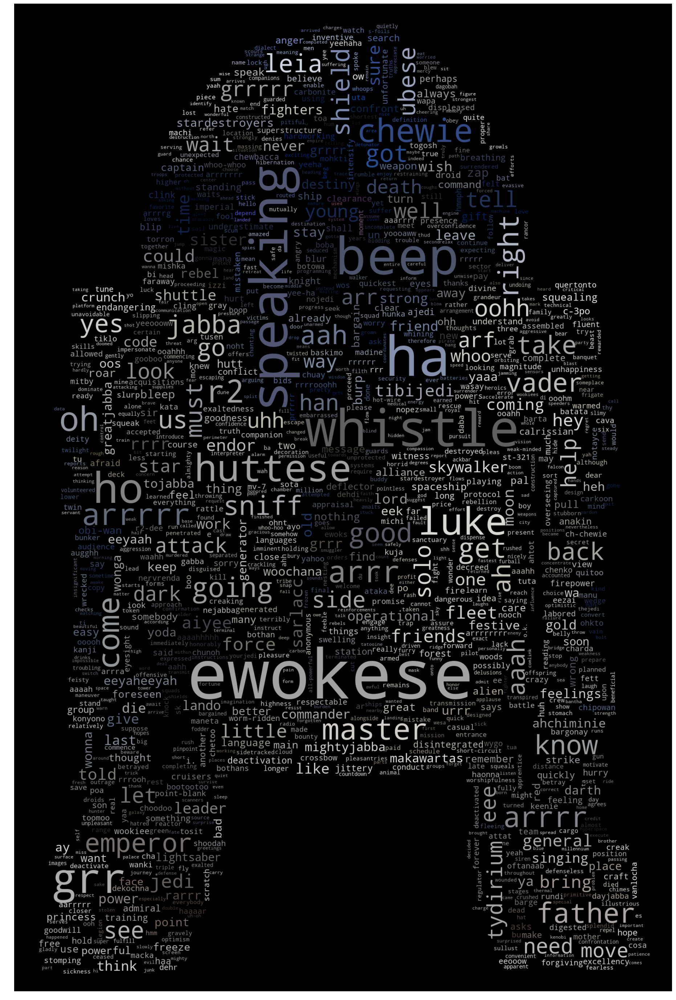

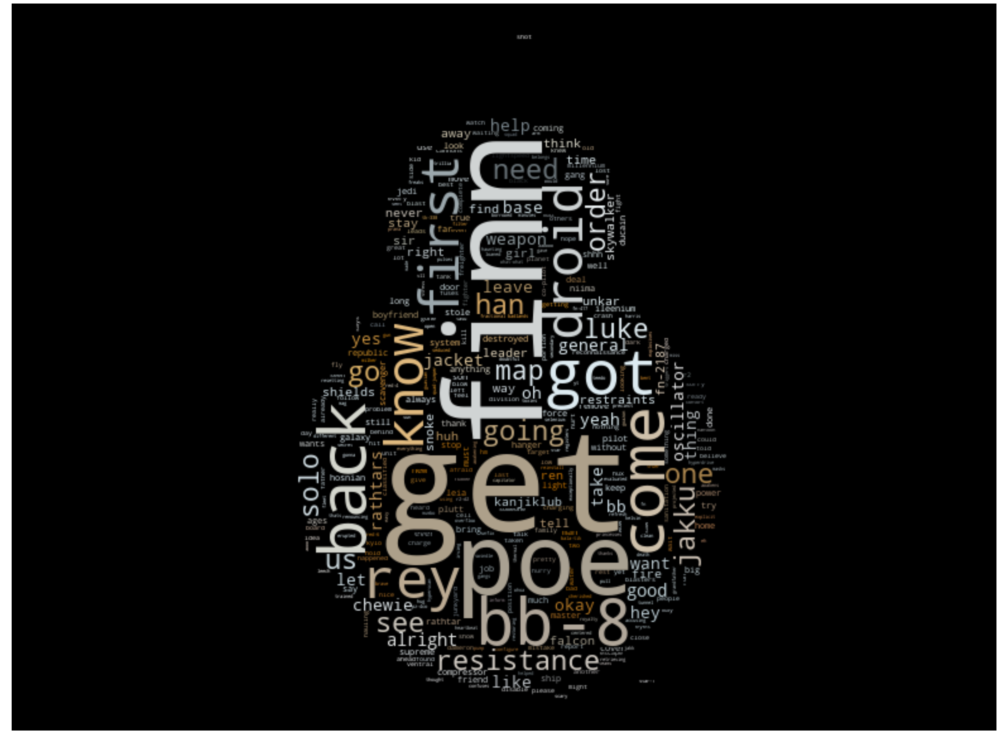

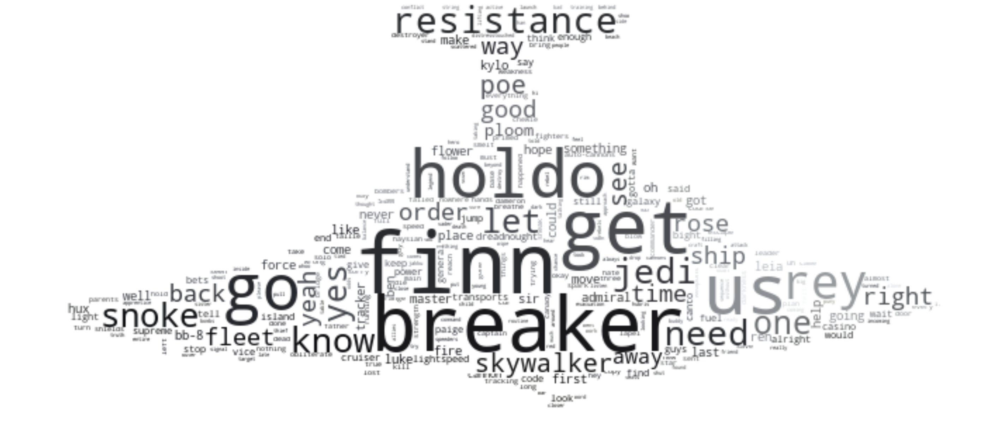

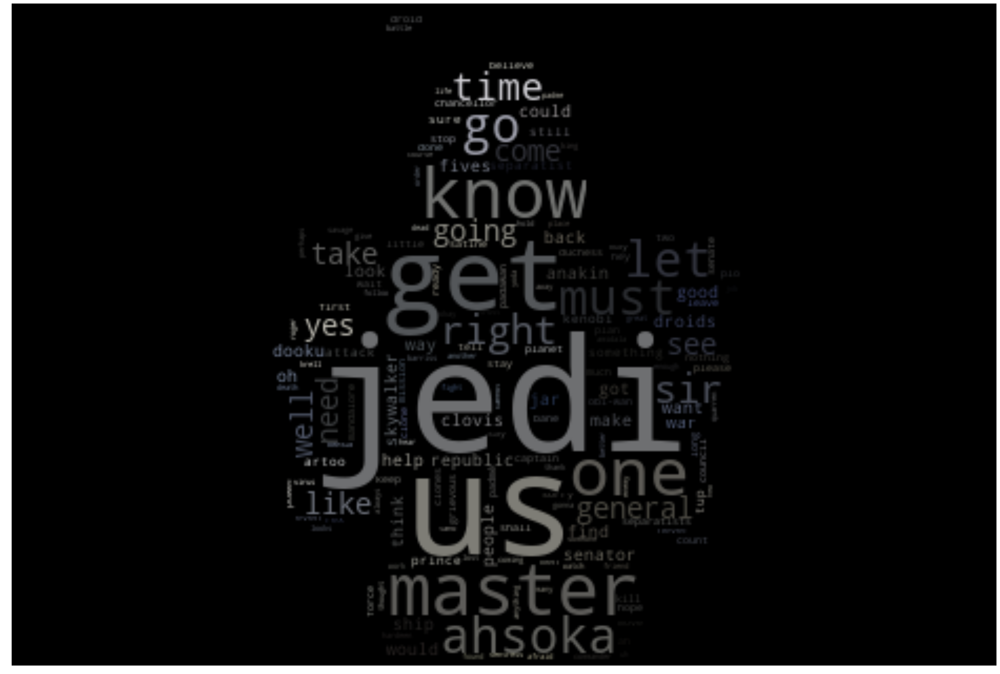

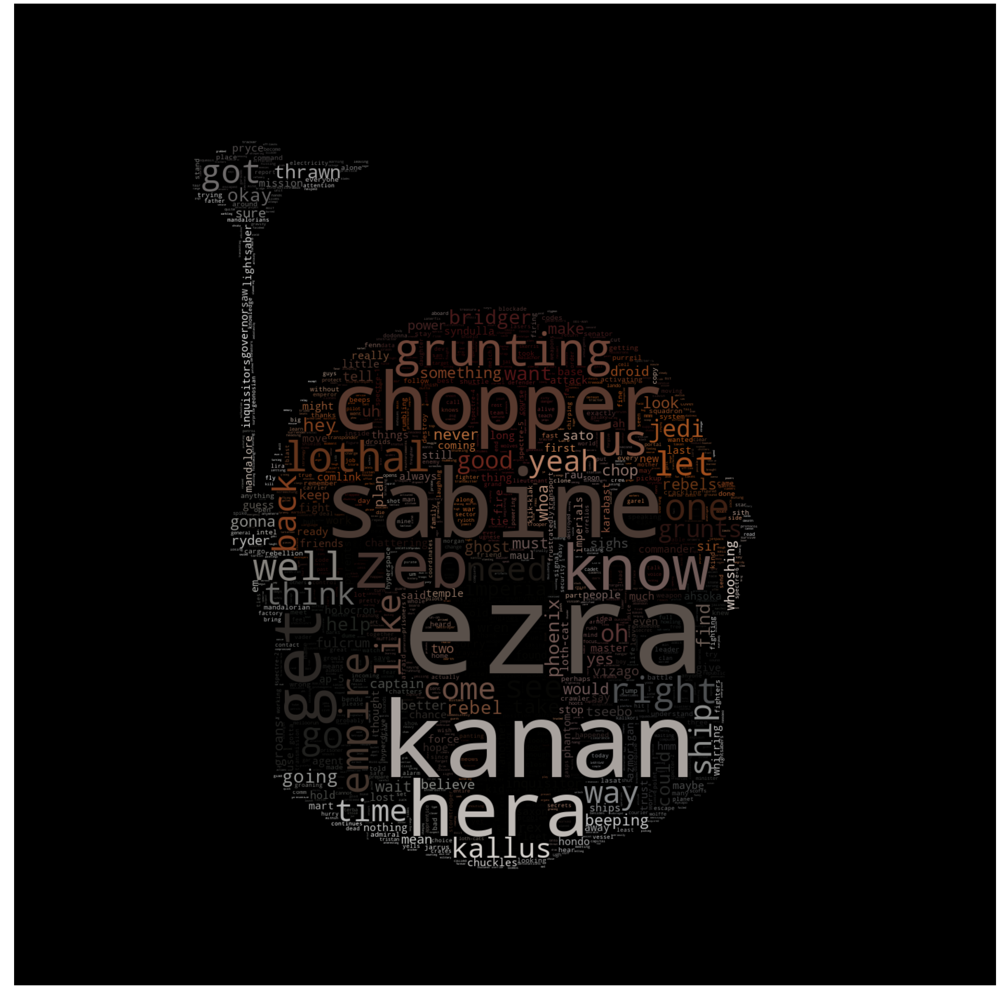

In [158]:
def grey_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(0, 0%%, %d%%)" % random.randint(60, 100)

masks = ["Data/WordCloudMasks/maul_mask.jpg", "Data/WordCloudMasks/clone_trooper_mask.jpg", "Data/WordCloudMasks/ahsoka3.jpg",
        "Data/WordCloudMasks/yoda_mask2.jpg", "Data/WordCloudMasks/chewy_mask.jpg", "Data/WordCloudMasks/darth_vader2.jpg",
        "Data/WordCloudMasks/xwing.jpg", "Data/WordCloudMasks/stormtrooper_mask.png", "Data/WordCloudMasks/R2D2_mask.jpg",
        "Data/WordCloudMasks/bb8_mask.jpg", "Data/WordCloudMasks/star_destroyer_mask.jpg"]
coloring = ["Data/WordCloudMasks/maul_colors.jpg", "Data/WordCloudMasks/clone_trooper.jpg", "Data/WordCloudMasks/ahsoka3.jpg",
           "Data/WordCloudMasks/yoda_mask2.jpg", "Data/WordCloudMasks/chewy.jpg", "Data/WordCloudMasks/darth_vader2.jpg",
           "Data/WordCloudMasks/xwing.jpg", None, "Data/WordCloudMasks/R2D2.png", "Data/WordCloudMasks/bb8.jpg",
           "Data/WordCloudMasks/star_destroyer.jpg"]
backgrounds = ["black", "black", "black", "black", "black", "white", "white", "black", "black", "black", "white"]
i = 0
for m in movies:
    print m
    df_tfidf = transcript_tokens[m]["TFIDF"]
    print len(df_tfidf)
    df_tfidf.index = df_tfidf.word
    df_tfidf.TFIDF = np.ceil(df_tfidf.TFIDF.values)
    mask = np.array(Image.open(masks[i]))
    if coloring[i] is not None:
        image_colors = ImageColorGenerator(np.array(Image.open(coloring[i])))
    wc = WordCloud(background_color=backgrounds[i], max_words=2000, mask=mask).generate_from_frequencies(df_tfidf["TFIDF"].to_dict())
#     plt.figure(figsize=(10,10))
#     plt.imshow(wc, interpolation="bilinear")

    # show
    plt.figure(figsize=(50,50))
    if coloring[i] is not None:
        plt.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
    else:
        plt.imshow(wc.recolor(color_func=grey_color_func), interpolation="bilinear")

    plt.axis("off")
    directory = os.path.join("Data", m.replace(" ", "_").replace(":",""))
    if not os.path.exists(directory):
        os.makedirs(directory)

    plt.savefig(os.path.join(directory, "wordcloud.png"))
    i+=1
#     break
    
masks = ["Data/WordCloudMasks/cpt_rex_mask.jpg", "Data/WordCloudMasks/sabine2.jpg"]
coloring = ["Data/WordCloudMasks/cpt_rex.jpg", "Data/WordCloudMasks/sabine2.jpg"]
i = 0
for s in animated_series_names:
    print s
    df_tfidf = transcript_tokens[s]["TFIDF"]
    print len(df_tfidf)
    df_tfidf.index = df_tfidf.word
    df_tfidf.TFIDF = np.ceil(df_tfidf.TFIDF.values)
    mask = np.array(Image.open(masks[i]))
    if coloring[i] is not None:
        image_colors = ImageColorGenerator(np.array(Image.open(coloring[i])))
    wc = WordCloud(background_color=backgrounds[i], max_words=2000, mask=mask).generate_from_frequencies(df_tfidf["TFIDF"].to_dict())
#     plt.figure(figsize=(10,10))
#     plt.imshow(wc, interpolation="bilinear")

    # show
    plt.figure(figsize=(50,50))
    if coloring[i] is not None:
        plt.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
    else:
        plt.imshow(wc.recolor(color_func=grey_color_func), interpolation="bilinear")

    plt.axis("off")
    
    directory = os.path.join("Data", s.replace(" ", "_").replace(":",""))
    if not os.path.exists(directory):
        os.makedirs(directory)

    plt.savefig(os.path.join(directory, "wordcloud.png"))
    i+=1

# Character sentiment

In [159]:
with open("Data/starwars_vader_split.json") as f:
    starwars_json = json.load(f)

In [166]:
dataframes = []
char_sentiment = defaultdict(dict)
exclude_from_nodes = set(["canon", "hologram"])
chars = list(set(starwars_json["data"]["characters"].keys()).difference(set(starwars_json["failed"]["characters"].keys()).union(exclude_from_nodes)))
for i in range(len(chars)):
    c = chars[i]
    text = starwars_json["data"]["characters"][c]["wikicontent"]
    tokens = []

    # Only detect words and abbreviations, not numbers or punctuations
    pattern = r'''(?x)    # set flag to allow verbose regexps
        (?:[A-Z]\.)+        # abbreviations, e.g. U.S.A.
      | [A-Za-z]\w*(?:-\w+)*  # words with optional internal hyphens
      '''
    stopw = stopwords.words('english')
    other_words = []
    # Tokenize the text with regex
    tokens = nltk.regexp_tokenize(text, pattern)
    # Exclude twitter handles and stopwords from the list of tokens and set the token to lowercase
    tokens = [t.lower() for t in tokens if ((t.lower() not in stopw) and (t.lower() not in other_words))]

    df_tokens = pd.DataFrame(data=dict(word=tokens))
    dataframes.append(df_tokens)
    char_sentiment[m]["tokens"] = df_tokens
    char_sentiment[m]["sentiment"] = evaluate_sentiment(tokens)

tfidf_dataframes = TFIDF(dataframes)
for i in range(len(chars)):
    c = chars[i]
    char_sentiment[c]["TFIDF"] = tfidf_dataframes[i]

